# Forest Cover Type Analysis and Prediction

### Import Libraries

In [1]:
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots
#Some Styling
import plotly.io as pio
pio.templates.default = "plotly_dark"
sns.set_style("darkgrid")


#displaying markdown
from IPython.display import Markdown
def bold(string):
    display(Markdown(string))
    

import os
for dirname, _, filenames in os.walk('/home/ibab/Applications/Jupyter/forest-cover-type-prediction'):
    for filename in filenames:
        print(os.path.join(dirname, filename))
        
# Disable warnings 
import warnings
warnings.filterwarnings('ignore')

/home/ibab/Applications/Jupyter/forest-cover-type-prediction/test.csv.zip
/home/ibab/Applications/Jupyter/forest-cover-type-prediction/Forest_Cover-Type.ipynb
/home/ibab/Applications/Jupyter/forest-cover-type-prediction/sampleSubmission.csv.zip
/home/ibab/Applications/Jupyter/forest-cover-type-prediction/train.csv
/home/ibab/Applications/Jupyter/forest-cover-type-prediction/test3.csv
/home/ibab/Applications/Jupyter/forest-cover-type-prediction/train.csv.zip
/home/ibab/Applications/Jupyter/forest-cover-type-prediction/sampleSubmission.csv
/home/ibab/Applications/Jupyter/forest-cover-type-prediction/test.csv
/home/ibab/Applications/Jupyter/forest-cover-type-prediction/.ipynb_checkpoints/Forest_Cover-Type-checkpoint.ipynb


### Load Dataset

In [2]:
forest = pd.read_csv("/home/ibab/Applications/Jupyter/forest-cover-type-prediction/train.csv")

In [3]:
forest.head()

,Id,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,...,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
0,1,2596,51,3,258,0,510,221,232,148,...,0,0,0,0,0,0,0,0,0,5
1,2,2590,56,2,212,-6,390,220,235,151,...,0,0,0,0,0,0,0,0,0,5
2,3,2804,139,9,268,65,3180,234,238,135,...,0,0,0,0,0,0,0,0,0,2
3,4,2785,155,18,242,118,3090,238,238,122,...,0,0,0,0,0,0,0,0,0,2
4,5,2595,45,2,153,-1,391,220,234,150,...,0,0,0,0,0,0,0,0,0,5


### Dataset Info

The dataset includes four wilderness areas located in the Roosevelt National Forest of northern Colorado.

Each observation is a 30m x 30m patch.

* Elevation - Elevation in meters
* Aspect - Aspect in degrees azimuth

To study how aspect works , please refer the following website 
https://pro.arcgis.com/en/pro-app/tool-reference/3d-analyst/how-aspect-works.htm 
that explains how it works.

To study how aspect works , please refer the following website
https://pro.arcgis.com/en/pro-app/tool-reference/3d-analyst/slope.htm

* Slope - Slope in degrees
* Horizontal_Distance_To_Hydrology - Horz Dist to nearest surface water features
* Vertical_Distance_To_Hydrology - Vert Dist to nearest surface water features
* Horizontal_Distance_To_Roadways - Horz Dist to nearest roadway
* Hillshade_9am (0 to 255 index) - Hillshade index at 9am, summer solstice

To study how aspect works , please refer the following website
https://pro.arcgis.com/en/pro-app/tool-reference/3d-analyst/hillshade.htm

* Hillshade_Noon (0 to 255 index) - Hillshade index at noon, summer solstice
* Hillshade_3pm (0 to 255 index) - Hillshade index at 3pm, summer solstice
* Horizontal_Distance_To_Fire_Points - Horz Dist to nearest wildfire ignition points
* Wilderness_Area (4 binary columns, 0 = absence or 1 = presence) - Wilderness area designation
* Soil_Type (40 binary columns, 0 = absence or 1 = presence) - Soil Type designation
* Cover_Type (7 types, integers 1 to 7) - Forest Cover Type designation

#### Seven Types of Forest Cover
1 - Spruce/Fir

2 - Lodgepole Pine

3 - Ponderosa Pine

4 - Cottonwood/Willow

5 - Aspen

6 - Douglas-fir

7 - Krummholz

#### Wilderness Areas

1 - Rawah Wilderness Area

2 - Neota Wilderness Area

3 - Comanche Peak Wilderness Area

4 - Cache la Poudre Wilderness Area

### Descriptive Statistics

In [4]:
forest.shape

(15120, 56)

In [5]:
forest.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15120 entries, 0 to 15119
Data columns (total 56 columns):
Id                                    15120 non-null int64
Elevation                             15120 non-null int64
Aspect                                15120 non-null int64
Slope                                 15120 non-null int64
Horizontal_Distance_To_Hydrology      15120 non-null int64
Vertical_Distance_To_Hydrology        15120 non-null int64
Horizontal_Distance_To_Roadways       15120 non-null int64
Hillshade_9am                         15120 non-null int64
Hillshade_Noon                        15120 non-null int64
Hillshade_3pm                         15120 non-null int64
Horizontal_Distance_To_Fire_Points    15120 non-null int64
Wilderness_Area1                      15120 non-null int64
Wilderness_Area2                      15120 non-null int64
Wilderness_Area3                      15120 non-null int64
Wilderness_Area4                      15120 non-null int64
Soil_T

### Description

In [6]:
forest.iloc[:,1:17].describe()

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,Wilderness_Area1,Wilderness_Area2,Wilderness_Area3,Wilderness_Area4,Soil_Type1,Soil_Type2
count,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000
mean,2749.322553,156.676653,16.501587,227.195701,51.076521,1714.023214,212.704299,218.965608,135.091997,1511.147288,0.237897,0.033003,0.419907,0.309193,0.023479,0.041204
std,417.678187,110.085801,8.453927,210.075296,61.239406,1325.066358,30.561287,22.801966,45.895189,1099.936493,0.425810,0.178649,0.493560,0.462176,0.151424,0.198768
min,1863.000000,0.000000,0.000000,0.000000,-146.000000,0.000000,0.000000,99.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2376.000000,65.000000,10.000000,67.000000,5.000000,764.000000,196.000000,207.000000,106.000000,730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,2752.000000,126.000000,15.000000,180.000000,32.000000,1316.000000,220.000000,223.000000,138.000000,1256.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,3104.000000,261.000000,22.000000,330.000000,79.000000,2270.000000,235.000000,235.000000,167.000000,1988.250000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000
max,3849.000000,360.000000,52.000000,1343.000000,554.000000,6890.000000,254.000000,254.000000,248.000000,6993.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [7]:
forest.iloc[:,17:37].describe()

,Soil_Type3,Soil_Type4,Soil_Type5,Soil_Type6,Soil_Type7,Soil_Type8,Soil_Type9,Soil_Type10,Soil_Type11,Soil_Type12,Soil_Type13,Soil_Type14,Soil_Type15,Soil_Type16,Soil_Type17,Soil_Type18,Soil_Type19,Soil_Type20,Soil_Type21,Soil_Type22
count,15120.000000,15120.000000,15120.000000,15120.000000,15120.0,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.0,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000
mean,0.063624,0.055754,0.010913,0.042989,0.0,0.000066,0.000661,0.141667,0.026852,0.015013,0.031481,0.011177,0.0,0.007540,0.040476,0.003968,0.003042,0.009193,0.001058,0.022817
std,0.244091,0.229454,0.103896,0.202840,0.0,0.008133,0.025710,0.348719,0.161656,0.121609,0.174621,0.105133,0.0,0.086506,0.197080,0.062871,0.055075,0.095442,0.032514,0.149326
min,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,0.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [8]:
forest.iloc[:,37:].describe()

,Soil_Type23,Soil_Type24,Soil_Type25,Soil_Type26,Soil_Type27,Soil_Type28,Soil_Type29,Soil_Type30,Soil_Type31,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
count,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000
mean,0.050066,0.016997,0.000066,0.003571,0.000992,0.000595,0.085384,0.047950,0.021958,0.045635,0.040741,0.001455,0.006746,0.000661,0.002249,0.048148,0.043452,0.030357,4.000000
std,0.218089,0.129265,0.008133,0.059657,0.031482,0.024391,0.279461,0.213667,0.146550,0.208699,0.197696,0.038118,0.081859,0.025710,0.047368,0.214086,0.203880,0.171574,2.000066
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,7.000000


#### Skewness is a measure of symmetry in a distribution.
* If the skewness is equal to zero,data is perfectly symmetrical.
* if skewness is positive, the data are positively skewed or skewed right.
* if skewness is negative, the data are negatively skewed or skewed left.

In [9]:
forest.skew()

Id                                      0.000000
Elevation                               0.075640
Aspect                                  0.450935
Slope                                   0.523658
Horizontal_Distance_To_Hydrology        1.488052
Vertical_Distance_To_Hydrology          1.537776
Horizontal_Distance_To_Roadways         1.247811
Hillshade_9am                          -1.093681
Hillshade_Noon                         -0.953232
Hillshade_3pm                          -0.340827
Horizontal_Distance_To_Fire_Points      1.617099
Wilderness_Area1                        1.231244
Wilderness_Area2                        5.228781
Wilderness_Area3                        0.324594
Wilderness_Area4                        0.825798
Soil_Type1                              6.294716
Soil_Type2                              4.617019
Soil_Type3                              3.575995
Soil_Type4                              3.872721
Soil_Type5                              9.416209
Soil_Type6          

We can see that many are positively skewed and Soil_Type8 and Soil_Type25 are highly positively skewed.

Hillshade data are negatively skewed.

* And we'll have a better look at the skewness with the help of boxplots.

### Missing Values

In [10]:
forest.isna().sum()

Id                                    0
Elevation                             0
Aspect                                0
Slope                                 0
Horizontal_Distance_To_Hydrology      0
Vertical_Distance_To_Hydrology        0
Horizontal_Distance_To_Roadways       0
Hillshade_9am                         0
Hillshade_Noon                        0
Hillshade_3pm                         0
Horizontal_Distance_To_Fire_Points    0
Wilderness_Area1                      0
Wilderness_Area2                      0
Wilderness_Area3                      0
Wilderness_Area4                      0
Soil_Type1                            0
Soil_Type2                            0
Soil_Type3                            0
Soil_Type4                            0
Soil_Type5                            0
Soil_Type6                            0
Soil_Type7                            0
Soil_Type8                            0
Soil_Type9                            0
Soil_Type10                           0


As we can see , there are no missing values in this dataset.

We are good to go.

The target variable of our data i.e Cover_Type is one hot encoded.

We replace the foresteric values back to their original values for better analysis.

In [11]:
forest['Cover_Type'].replace({1:'Spruce/Fir', 2:'Lodgepole Pine', 3:'Ponderosa Pine', 4:'Cottonwood/Willow', 5:'Aspen', 6:'Douglas-fir', 7:'Krummholz'}, inplace=True)

forest = forest.rename(columns={"Wilderness_Area1":"Rawah_WA","Wilderness_Area2":"Neota_WA",
"Wilderness_Area3":"Comanche_Peak_WA","Wilderness_Area4":"Cache_la_Poudre_WA","Horizontal_Distance_To_Hydrology":"HD_Hydrology",
"Vertical_Distance_To_Hydrology":"VD_Hydrology","Horizontal_Distance_To_Roadways":"HD_Roadways",
                               "Horizontal_Distance_To_Fire_Points":"HD_Fire_Points"})

In [12]:
#We can see the new column names......

forest.columns

Index(['Id', 'Elevation', 'Aspect', 'Slope', 'HD_Hydrology', 'VD_Hydrology',
       'HD_Roadways', 'Hillshade_9am', 'Hillshade_Noon', 'Hillshade_3pm',
       'HD_Fire_Points', 'Rawah_WA', 'Neota_WA', 'Comanche_Peak_WA',
       'Cache_la_Poudre_WA', 'Soil_Type1', 'Soil_Type2', 'Soil_Type3',
       'Soil_Type4', 'Soil_Type5', 'Soil_Type6', 'Soil_Type7', 'Soil_Type8',
       'Soil_Type9', 'Soil_Type10', 'Soil_Type11', 'Soil_Type12',
       'Soil_Type13', 'Soil_Type14', 'Soil_Type15', 'Soil_Type16',
       'Soil_Type17', 'Soil_Type18', 'Soil_Type19', 'Soil_Type20',
       'Soil_Type21', 'Soil_Type22', 'Soil_Type23', 'Soil_Type24',
       'Soil_Type25', 'Soil_Type26', 'Soil_Type27', 'Soil_Type28',
       'Soil_Type29', 'Soil_Type30', 'Soil_Type31', 'Soil_Type32',
       'Soil_Type33', 'Soil_Type34', 'Soil_Type35', 'Soil_Type36',
       'Soil_Type37', 'Soil_Type38', 'Soil_Type39', 'Soil_Type40',
       'Cover_Type'],
      dtype='object')

In [13]:
# Here I have converted the encoded values for columns Wilderness_Areas 
#and Soil_types back to a single column for better analysis.

forest['Wild Areas'] = (forest.iloc[:,11:15] == 1).idxmax(1)
forest['Soil types'] = (forest.iloc[:,15:55] == 1).idxmax(1)

#Drop the columns which are not required now
forest = forest.drop(columns=["Id",'Rawah_WA', 'Neota_WA', 'Comanche_Peak_WA',
       'Cache_la_Poudre_WA', 'Soil_Type1', 'Soil_Type2', 'Soil_Type3',
       'Soil_Type4', 'Soil_Type5', 'Soil_Type6', 'Soil_Type7', 'Soil_Type8',
       'Soil_Type9', 'Soil_Type10', 'Soil_Type11', 'Soil_Type12',
       'Soil_Type13', 'Soil_Type14', 'Soil_Type15', 'Soil_Type16',
       'Soil_Type17', 'Soil_Type18', 'Soil_Type19', 'Soil_Type20',
       'Soil_Type21', 'Soil_Type22', 'Soil_Type23', 'Soil_Type24',
       'Soil_Type25', 'Soil_Type26', 'Soil_Type27', 'Soil_Type28',
       'Soil_Type29', 'Soil_Type30', 'Soil_Type31', 'Soil_Type32',
       'Soil_Type33', 'Soil_Type34', 'Soil_Type35', 'Soil_Type36',
       'Soil_Type37', 'Soil_Type38', 'Soil_Type39', 'Soil_Type40'])
#I don't like this big Soil_Type name
#Let's replace it with some short name
#Which will help us in visualizations
lst = []
for value in forest['Soil types']:
    value = value.replace('Soil_Type',"ST")
    lst.append(value)
    
forest['Soil types'] = lst

In [14]:
'''forest = forest[['Elevation', 'Aspect', 'Slope',
       'HD_Hydrology', 'VD_Hydrology','HD_Fire_Points',
       'HD_Roadways', 'Hillshade_9am', 'Hillshade_Noon',
       'Hillshade_3pm','Cover_Type']]
cat = forest[['Wild Areas', 'Soil types',"Cover_Type"]]
'''

'forest = forest[[\'Elevation\', \'Aspect\', \'Slope\',\n       \'HD_Hydrology\', \'VD_Hydrology\',\'HD_Fire_Points\',\n       \'HD_Roadways\', \'Hillshade_9am\', \'Hillshade_Noon\',\n       \'Hillshade_3pm\',\'Cover_Type\']]\ncat = forest[[\'Wild Areas\', \'Soil types\',"Cover_Type"]]\n'

## Feature Analysis..

##### Let's Look at the categorical features first and then we can compare all the numerical features with them.

In [15]:
fig = px.histogram(forest,x="Cover_Type",color="Cover_Type",height=400,width=800)
fig.show()

* We can see we have same amount of data for all the forest covers.
* Does that mean same amount of data is taken from the four Wild Areas.
* Let's have a look.

### Wilderness Areas

#### The dataset consists of four wilderness areas located in the Roosevelt National Forest of northern Colorado.

In [16]:
fig = px.pie(forest,names="Wild Areas",height=300,width=800)
fig.show()

fig = px.histogram(forest,x="Wild Areas",color="Cover_Type",barmode="group",
                   height=400,width=800)
fig.show()

* No we can clearly see the difference in the above plots.


##### Rawah_WA
* Krummholz
* Spruce/Fir
* Lodgepole Pine
* Aspen

##### Comanche_Peak_WA
* Krummholz
* Spruce/Fir
* Lodgepole Pine
* Aspen
* Douglas-fir
* Ponderosa Pine

##### Cache_La_Poudre
* Cottonwood/Willow
* Douglas-fir
* Ponderosa Pine

##### Neota_WA
* Krummholz
* Spruce/Fir
* Lodgepole Pine


Cache_La_Poudre and Neota Wilderness Areas have same forestber of forest covers.

But Neota Wild Area has least forestber of forests compared to other wild areas.

Comanche_Peak accounts for 42% of the total Wild Areas data.

The least data is for Neota Wild Area

We can also see that none of the wild areas have all the types of forest covers.

### Soil Types

In [17]:
fig = px.histogram(forest,x="Soil types",color="Cover_Type",height=400,width=900)
fig.show()

fig = px.pie(forest,names="Soil types",height=400,width=900)
fig.show()

##### Pie chart gives us a proper view 

* We have most of the data for soil type 10 and 29.
* Many soil types are rare in our data

You can just move the cursor over the pie chart for the soil types with low percentage.

#### The below histogram plot tells us types of soil in each wild area

In [18]:
temp =forest[forest['Wild Areas']=="Rawah_WA"][['Wild Areas','Soil types',"Cover_Type"]]
fig = px.histogram(temp,x="Soil types",color="Cover_Type",height=500,width=1000,
                  title="Rawah Wild Area",barmode="group")
fig.show()

temp =forest[forest['Wild Areas']=="Comanche_Peak_WA"][['Wild Areas','Soil types',"Cover_Type"]]
fig = px.histogram(temp,x="Soil types",color="Cover_Type",height=500,width=1000,
                  title="Comanche Peak Area",barmode="group")
fig.show()

temp =forest[forest['Wild Areas']=="Cache_la_Poudre_WA"][['Wild Areas','Soil types',"Cover_Type"]]
fig = px.histogram(temp,x="Soil types",color="Cover_Type",height=500,width=1000,
                  title="Cache la Poudre Wild Area",barmode="group")
fig.show()

temp =forest[forest['Wild Areas']=="Neota_WA"][['Wild Areas','Soil types',"Cover_Type"]]
fig = px.histogram(temp,x="Soil types",color="Cover_Type",height=500,width=1000,
                  title="Neota Wild Area",barmode="group")
fig.show()

#### Let's start with the numerical features now

#### Elevation

In [19]:
fig = px.histogram(forest,x="Elevation",color="Cover_Type",marginal='rug',title="Elevation Histogram",
                  height=500,width=800)
fig.show()

* Elevation Histogram :- 

    All the Forest cover types are highly distributed.
    The above plot shows us that Cottonwood tress grow at a lower elevated regions compared to Krummholz,
    Spruce and Lodgepole tress grow at higher elevation.

In [20]:
fig = px.box(forest,x="Cover_Type",y="Elevation",color="Cover_Type",height=400,width=900)
fig.update_layout(title={'text':"Elevation Box Plot"})
fig.show()

In [21]:
temp = forest.groupby(['Cover_Type'],as_index=False)[["Elevation"]].median()
temp.sort_values(by="Elevation",ascending=False).style.background_gradient(cmap="Reds")

,Cover_Type,Elevation
3,Krummholz,3364
6,Spruce/Fir,3144
4,Lodgepole Pine,2931.5
0,Aspen,2793
2,Douglas-fir,2430
5,Ponderosa Pine,2409
1,Cottonwood/Willow,2230.5


The above table is calculated by taking the median value for each forest cover type.
And we see that on avg , krummholz,Spruce and Lodgepole trees grow on higher elevation and douglas,Ponderosa and Cottonwood at lower elevation.

* Now let's look at the elevation for each forest cover in each wild area.

In [22]:
#Let's look have a look at the wild areas 
#and how are the forest covers distributed in these areas along with these features.

temp = forest.groupby(['Wild Areas','Cover_Type'],as_index=False)[['Elevation']].median()

#Both barplot and treemap help in better understanding the features.
fig = px.bar(temp, x="Wild Areas", y="Elevation", color='Cover_Type', barmode='group',
             height=400,width=900)
fig.show()

fig = px.treemap(temp, path=['Wild Areas','Cover_Type'],values='Elevation',height=400,width=900)
fig.show()

temp.style.background_gradient(cmap='Greens')

,Wild Areas,Cover_Type,Elevation
0,Cache_la_Poudre_WA,Cottonwood/Willow,2230.5
1,Cache_la_Poudre_WA,Douglas-fir,2336
2,Cache_la_Poudre_WA,Lodgepole Pine,2484.5
3,Cache_la_Poudre_WA,Ponderosa Pine,2302
4,Comanche_Peak_WA,Aspen,2815
5,Comanche_Peak_WA,Douglas-fir,2571
6,Comanche_Peak_WA,Krummholz,3366
7,Comanche_Peak_WA,Lodgepole Pine,2941
8,Comanche_Peak_WA,Ponderosa Pine,2576
9,Comanche_Peak_WA,Spruce/Fir,3144


* We can see that Krummholz and Spruce,Fir trees are located at higher elevation in all the four wild areas
compared to other trees.

### Aspect

According to the information found on the website, aspect identifies the direction of the downhill slope faces. 

It is measured clockwise in degrees from 0 (due north) to 360 (again due north), coming full circle. 

Flat areas having no downslope direction are given a value of -1.

In [23]:
fig = px.histogram(forest,x="Aspect",color="Cover_Type",marginal='rug',title="Aspect Histogram",
                  height=500,width=900)
fig.show()

The above histogram plot doesn't help us much .
* Aspect :- I don't see any difference in cover types with aspect values . As I don't have any much knowledge on how aspect works , Let's just look at how it relates with wild areas.


We can use the below table for better understanding.

In [24]:
temp = forest.groupby(['Wild Areas','Cover_Type'],as_index=False)[['Aspect']].median()

fig = px.bar(temp, x="Wild Areas", y="Aspect", color='Cover_Type', barmode='group',
             height=400,width=900)
fig.show()

fig = px.treemap(temp, path=['Wild Areas','Cover_Type'],values='Aspect',height=400,width=900)
fig.show()

temp.style.background_gradient(cmap='YlGnBu')

,Wild Areas,Cover_Type,Aspect
0,Cache_la_Poudre_WA,Cottonwood/Willow,119
1,Cache_la_Poudre_WA,Douglas-fir,274
2,Cache_la_Poudre_WA,Lodgepole Pine,285.5
3,Cache_la_Poudre_WA,Ponderosa Pine,178
4,Comanche_Peak_WA,Aspen,153
5,Comanche_Peak_WA,Douglas-fir,91.5
6,Comanche_Peak_WA,Krummholz,155
7,Comanche_Peak_WA,Lodgepole Pine,153
8,Comanche_Peak_WA,Ponderosa Pine,155
9,Comanche_Peak_WA,Spruce/Fir,162


* From what we know, we can say that trees in Rawah Wild Areas have aspect degree in range 80-105.
* So these trees are likely to be found on sites that have a east facing downhill direction.
* And Douglas fir and Lodgepole trees in Cache la Poudre wild area are to be found on areas that have 
* west facing downhill direction.

### Slope

In [25]:
fig = px.histogram(forest,x="Slope",color="Cover_Type",marginal='rug',title="Slope Histogram",
                  height=500,width=800)
fig.show()

This plot also doesn't help us much

* Slope :- Above histogram follows a bit uniform distribution with some values right skewed.

* Some trees having a higher slope like Ponderosa Pine and Douglas Fir in Cache la Poudre wild area and 
* Aspen tree in Rawah wild area.

* All the trees have thier slope in range 10 - 20 as seen in below bar plot.

In [26]:
temp = forest.groupby(['Wild Areas','Cover_Type'],as_index=False)[['Slope']].median()

fig = px.bar(temp, x="Wild Areas", y="Slope", color='Cover_Type', barmode='group',
             height=400,width=900)
fig.show()

### Distance to nearest surface water

In [27]:
fig = px.histogram(forest,x="HD_Hydrology",color="Cover_Type",marginal='rug',title="HD_Hydrology Histogram",
                  height=500,width=800)
fig.show()

* Horizontal Distance to Hydrology :- We can see a right skewed histogram that tells us that some of the forest covers are located at higher distance from any surface water.

* The best way to check outliers and compare the medians is a box pot.

In [28]:
fig = px.box(forest,x="Cover_Type",y="HD_Hydrology",color="Cover_Type",height=500,width=800)
fig.update_layout(title={'text':"Horizontal Dis to Hydrology Box Plot"})
fig.show()

* With this boxplot , we can see a lot of outliers in Aspen,Lodgepole Pine , Spruce and other trees.
* Many of the Logdepole,Krummholz are located closer to surface waters, some are located at a distance more than 1500.
* But we are not able to compare the medians.
* We'll look at the bar plot that uses median as estimator.

In [29]:
#Let's look at their relation with wild areas.....
temp = forest.groupby(['Wild Areas','Cover_Type'],as_index=False)[['HD_Hydrology']].median()

fig = px.bar(temp, x="Wild Areas", y="HD_Hydrology", color='Cover_Type', barmode='group',
             height=400,width=900)
fig.show()

temp.style.background_gradient(cmap="Blues")


,Wild Areas,Cover_Type,HD_Hydrology
0,Cache_la_Poudre_WA,Cottonwood/Willow,30
1,Cache_la_Poudre_WA,Douglas-fir,162
2,Cache_la_Poudre_WA,Lodgepole Pine,120
3,Cache_la_Poudre_WA,Ponderosa Pine,180
4,Comanche_Peak_WA,Aspen,186
5,Comanche_Peak_WA,Douglas-fir,95
6,Comanche_Peak_WA,Krummholz,342
7,Comanche_Peak_WA,Lodgepole Pine,272
8,Comanche_Peak_WA,Ponderosa Pine,210
9,Comanche_Peak_WA,Spruce/Fir,256


* Cottonwood trees are fast-growing trees found growing along streams, rivers, and lowland areas and hence is the lowest in the barplot and table.
* Krummholz trees grow in rugged environments: cliffs, mountaintops, canyon walls and are hence more distance to any surface water is possible as shown above.
* Similarly , Lodgepole trees are commonly located near the ocean shore and in dry mountain forests.We can see many trees near surface water , some far away.
* Aspen trees generally grow in high-altitude areas above 5,000 feet but also exists at sea level where climate conditions are ideal.Some of the aspen trees as seen as outliers in box plot grow in high altitude most probably far away from water surface , most of them are located near water surface.

In [30]:
fig = px.histogram(forest,x="VD_Hydrology",color="Cover_Type",marginal='rug',title="VD_Hydrology Histogram",
                  height=500,width=800)
fig.show()

* Vertical Distance to Hydrology:- Here also we have a right skewed histogram that tells us that vertical distance to any nearby surface water is less.

In [31]:
#Let's look at their relation with wild areas.....
temp = forest.groupby(['Wild Areas','Cover_Type'],as_index=False)[['VD_Hydrology']].median()

fig = px.bar(temp, x="Wild Areas", y="VD_Hydrology", color='Cover_Type', barmode='group',
             height=400,width=900)
fig.show()
#We can also use treeplot for better visualization
fig = px.treemap(temp, path=['Wild Areas','Cover_Type'],values='VD_Hydrology',height=400,width=800)
fig.show()

temp.style.background_gradient(cmap="Blues")



,Wild Areas,Cover_Type,VD_Hydrology
0,Cache_la_Poudre_WA,Cottonwood/Willow,6
1,Cache_la_Poudre_WA,Douglas-fir,51
2,Cache_la_Poudre_WA,Lodgepole Pine,23
3,Cache_la_Poudre_WA,Ponderosa Pine,60
4,Comanche_Peak_WA,Aspen,35
5,Comanche_Peak_WA,Douglas-fir,15
6,Comanche_Peak_WA,Krummholz,54
7,Comanche_Peak_WA,Lodgepole Pine,44
8,Comanche_Peak_WA,Ponderosa Pine,40
9,Comanche_Peak_WA,Spruce/Fir,31


* Here also , if we calculate average distance for cottonwood tree to nearest surface water is the less compared to other trees.
* And Ponderosa and krummholz vertical distance is more than the other trees.

### Distance to Roadways

In [32]:
fig = px.histogram(forest,x="HD_Roadways",color="Cover_Type",marginal='rug',title="HD_Roadways Histogram",
                  height=500,width=800)
fig.show()

* HD Roadways:- Here also we have a right skewed . 
    By looking at the histogram of Cottonwood ,Douglas fir and Ponderosa Pine forest cover, they are the closet to roadways.
    Rest we can see , most of the trees are near to roadways and some are far from roadways.

* And by looking at the below barplot ,we justify the above statement.

In [33]:
#This plot shows us on average distance to roadways for each forest covers.
temp = forest.groupby(['Cover_Type'],as_index=False)[['HD_Roadways']].median()

fig = px.bar(temp.sort_values(by="HD_Roadways",ascending=False), x="HD_Roadways", y="Cover_Type", color='Cover_Type',orientation='h',
             height=300,width=900)
fig.show()

In [34]:
temp = forest.groupby(['Wild Areas','Cover_Type'],as_index=False)[['HD_Roadways']].median()

fig = px.bar(temp, x="Wild Areas", y="HD_Roadways", color='Cover_Type', barmode='group',
             height=400,width=900)
fig.show()

fig = px.treemap(temp, path=['Wild Areas','Cover_Type'],values='HD_Roadways',height=400,width=800)
fig.show()

temp.style.background_gradient(cmap="Reds")

,Wild Areas,Cover_Type,HD_Roadways
0,Cache_la_Poudre_WA,Cottonwood/Willow,942
1,Cache_la_Poudre_WA,Douglas-fir,834
2,Cache_la_Poudre_WA,Lodgepole Pine,701
3,Cache_la_Poudre_WA,Ponderosa Pine,644
4,Comanche_Peak_WA,Aspen,1667
5,Comanche_Peak_WA,Douglas-fir,1323.5
6,Comanche_Peak_WA,Krummholz,2780
7,Comanche_Peak_WA,Lodgepole Pine,1660.5
8,Comanche_Peak_WA,Ponderosa Pine,1273
9,Comanche_Peak_WA,Spruce/Fir,2190


* As we saw with distance to hydrology, here also Krummholz is located far away from roadways.
* Similary, Spruce and lodgepole trees are also located far away from roadways and surface waters.

* The reason for cottonwood,douglas,ponderosa being close to roadways can be thier uses.
* Cottonwood trees are widely grown for timber production along wet river banks, where their exceptional growth rate provides a large crop of wood within just 10–30 years.
* Douglas trees are one of the best timber trees and popular as christmas trees.
* Ponderosa trees are also important for timber production , in production of ponderosa pine lumber.
* All the three trees are used for timber production and closest to river banks and roadways for production.

### Horizontal distance to fire points..

In [35]:
fig = px.histogram(forest,x="HD_Fire_Points",color="Cover_Type",marginal='rug',title="HD Fire Points Histogram",
                  height=500,width=800)
fig.show()

In [36]:
fig = px.box(forest,x="Cover_Type",y="HD_Fire_Points",color="Cover_Type",height=500,width=800)
fig.update_layout(title={'text':"Horizontal Dis to Fire points Box Plot"})
fig.show()

* Some Aspen trees are way far than the other aspen trees as seen in above box plot and histogram and most are in range 
850 to 1934.Fire is a natural feature in much of the aspen ecosystem and is responsible for the abundance of aspen in the West and for the even-aged structure of most stands.
Aspen forest does not readily burn and fire reduces the overstory, stimulates shoots to sprout, and kills invading conifers growing in the aspen clone.
This may be the reason for it to be closer to fire points.
 


In [37]:
temp = forest.groupby(['Wild Areas','Cover_Type'],as_index=False)[['HD_Fire_Points']].median()

fig = px.bar(temp, x="Wild Areas", y="HD_Fire_Points", color='Cover_Type', barmode='group',
             height=400,width=900)
fig.show()

fig = px.treemap(temp, path=['Wild Areas','Cover_Type'],values='HD_Fire_Points',height=400,width=800)
fig.show()

temp.style.background_gradient(cmap="Oranges")


,Wild Areas,Cover_Type,HD_Fire_Points
0,Cache_la_Poudre_WA,Cottonwood/Willow,808
1,Cache_la_Poudre_WA,Douglas-fir,799.5
2,Cache_la_Poudre_WA,Lodgepole Pine,706
3,Cache_la_Poudre_WA,Ponderosa Pine,671
4,Comanche_Peak_WA,Aspen,1322
5,Comanche_Peak_WA,Douglas-fir,1286
6,Comanche_Peak_WA,Krummholz,1766
7,Comanche_Peak_WA,Lodgepole Pine,1448
8,Comanche_Peak_WA,Ponderosa Pine,1091
9,Comanche_Peak_WA,Spruce/Fir,1584


* Cottonwood tree seeds are highly flammable 
and particularly when they accumulate in piles or drifts, and can carry fire through yard and the best way to control
cottonwood trees is by preventing the cottonwood blossoms from forming seeds.
* Douglas fir and Ponderosa trees are both resistant to fire.
Douglas-fir and ponderosa pine are known for their fire tolerance in large part due to thick insulating bark that develops 
with age and protects the inner cambium from heat injury. 
* But in the case of Lodgepole pine, lodgepole pine trees also require the heat of fire to release their seeds. 
Fire also produces favourable conditions for the seeds of these pines to germinate. 
Lodgepole pine depend on fire to regenerate.
But in our data , as seen above in histogram and box plot , most of the trees are near to fire points, the
trees that are as outliers are far away from these points and these are many in forestber.
* Similar is the case with Krummholz trees.

* All the seven trees are closer to fire points , but due to many outliers in lodgepole,spruce ad krummholz trees,
we see them on top of the table and higher in bar plot.

* By looking at the plots, In Cache_la_Poudre wild area all trees are closer to fire points.
* And Rawah , almost including Aspen all trees are far away from fire points.
* Same thing to notice here,Lodgepole pine is present in all the wild areas,but closest in Cache_la_Poudre,
then Comanche , then Neota and farthest in Rawah Wild Area.

### Hillshade at 9am..

In [38]:
fig = px.histogram(forest,x="Hillshade_9am",color="Cover_Type",marginal='rug',title="Hillshade at 9am Histogram",
                  height=500,width=800)
fig.show()

* Here we see a left skewed histogram with all the trees having almost highest shade index at 9am.


In [39]:
temp = forest.groupby(['Wild Areas','Cover_Type'],as_index=False)[['Hillshade_9am']].median()

fig = px.bar(temp, x="Wild Areas", y="Hillshade_9am", color='Cover_Type', barmode='group',
             height=400,width=900)
fig.show()
#No use of treemap as we don't see any difference in bar plots.

* I don't see any difference as such in the trees with hillshade at 9am by looking at the histogram.

* But the bar plot tells us that , all trees grow at places where hillshade index at 9am is more.

### Hillshade at Noon

In [40]:
fig = px.histogram(forest,x="Hillshade_Noon",color="Cover_Type",marginal='rug',title="Hillshade at Noon Histogram",
                  height=500,width=800)
fig.show()

In [41]:
temp = forest.groupby(['Wild Areas','Cover_Type'],as_index=False)[['Hillshade_Noon']].median()

fig = px.bar(temp, x="Wild Areas", y="Hillshade_Noon", color='Cover_Type', barmode='group',
             height=400,width=900)
fig.show()


* Every forest cover in all the wild areas have same shade index at Noon.

### Hillshade at 3pm

In [42]:
fig = px.histogram(forest,x="Hillshade_3pm",color="Cover_Type",marginal='rug',title="Hillshade at 3pm Histogram",
                  height=500,width=800)
fig.show()

In [43]:
temp = forest.groupby(['Wild Areas','Cover_Type'],as_index=False)[['Hillshade_3pm']].median()

fig = px.bar(temp, x="Wild Areas", y="Hillshade_3pm", color='Cover_Type', barmode='group',
             height=400,width=900)
fig.show()

temp.style.background_gradient(cmap="Greys")

,Wild Areas,Cover_Type,Hillshade_3pm
0,Cache_la_Poudre_WA,Cottonwood/Willow,114
1,Cache_la_Poudre_WA,Douglas-fir,161
2,Cache_la_Poudre_WA,Lodgepole Pine,169
3,Cache_la_Poudre_WA,Ponderosa Pine,148
4,Comanche_Peak_WA,Aspen,144
5,Comanche_Peak_WA,Douglas-fir,138
6,Comanche_Peak_WA,Krummholz,145
7,Comanche_Peak_WA,Lodgepole Pine,145
8,Comanche_Peak_WA,Ponderosa Pine,136
9,Comanche_Peak_WA,Spruce/Fir,150


* At 3pm, all the trees in each wild area have higher hillshade index except Aspen in Rawah Wild area.

* The highest shade at 3pm can be seen for Douglas fir and Lodgepole forest covers located in Cache la wild area
* And Aspen in Rawah wild area.

#### So , we are done with both numerical and categorical features of our data.

#### Now , let's take a look at the correlation of our features among each other..

In [44]:
forest_corr = forest.corr()
forest_corr.style.background_gradient(cmap="Reds")

,Elevation,Aspect,Slope,HD_Hydrology,VD_Hydrology,HD_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,HD_Fire_Points
Elevation,1,-0.0110961,-0.31264,0.412712,0.122092,0.578659,0.0979002,0.215782,0.0895176,0.443563
Aspect,-0.0110961,1,0.028148,0.0407321,0.0564123,0.0661842,-0.593997,0.324912,0.635022,-0.0521692
Slope,-0.31264,0.028148,1,-0.0559759,0.265314,-0.277049,-0.200072,-0.612613,-0.326887,-0.239527
HD_Hydrology,0.412712,0.0407321,-0.0559759,1,0.652142,0.203397,-0.0338027,0.0800472,0.0808325,0.158817
VD_Hydrology,0.122092,0.0564123,0.265314,0.652142,1,0.011555,-0.0959299,-0.132948,-0.0355591,-0.0150483
HD_Roadways,0.578659,0.0661842,-0.277049,0.203397,0.011555,1,-0.00339803,0.240684,0.173882,0.486386
Hillshade_9am,0.0979002,-0.593997,-0.200072,-0.0338027,-0.0959299,-0.00339803,1,-0.0137124,-0.779965,0.0781441
Hillshade_Noon,0.215782,0.324912,-0.612613,0.0800472,-0.132948,0.240684,-0.0137124,1,0.614526,0.122098
Hillshade_3pm,0.0895176,0.635022,-0.326887,0.0808325,-0.0355591,0.173882,-0.779965,0.614526,1,0.0431625
HD_Fire_Points,0.443563,-0.0521692,-0.239527,0.158817,-0.0150483,0.486386,0.0781441,0.122098,0.0431625,1


We used styling here for better view on the correlation of the variables.

But a heatmap will give us more information on the correlation.

### Heatmap --> forest

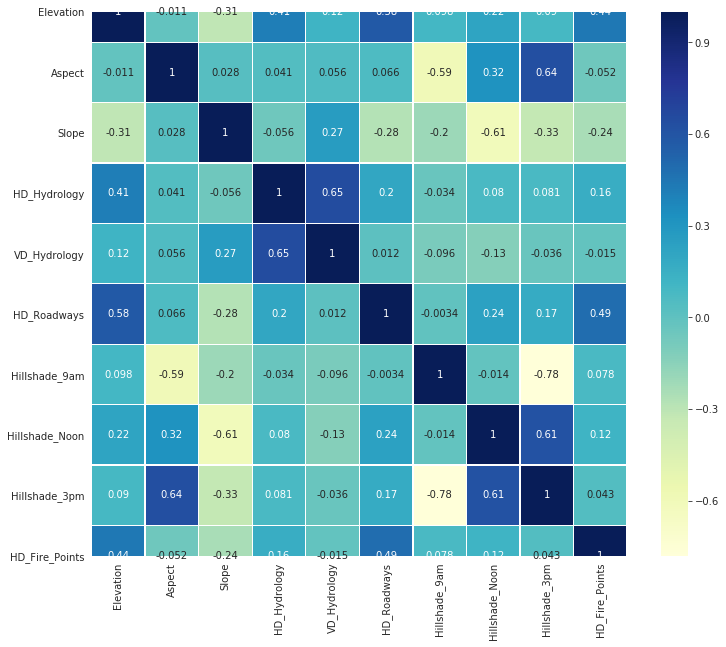

In [45]:
fig=plt.figure(figsize=(12,10))
sns.heatmap(forest_corr,annot=True,linewidths=.3,cmap="YlGnBu")

##### Correlated features

* We can see that elevation is co-related with horizontal distances to water surface,roadways and ignition points.
* Aspect is correlated with Hillshade at 3pm.
* Horizontal distance and vertical distance to water surface are correlated.
* Hillshade at noon and 3pm are correlated.

### Scatterplots

* Scatterplots are important in statistics as they show the extent of correlation.

We'll use scatterplot here for the above positive correlated features.

In [46]:
fig = px.scatter(forest,x='Elevation',y= 'HD_Roadways',color='Cover_Type',width=800,height=400)
fig.show()

#### Aspect and Hillshade 3pm

In [47]:
fig = px.scatter(forest,x='Aspect',y= 'Hillshade_3pm',color='Cover_Type',width=800,height=400)
fig.show()

#### Horizontal distance and Vertical distance to Hydrology.

In [48]:
fig = px.scatter(forest,x='HD_Hydrology',y= 'VD_Hydrology',color='Cover_Type',width=800,height=400)
fig.show()

#### Hillshade at Noon and 3pm

In [49]:
fig = px.scatter(forest,x='Hillshade_Noon',y= 'Hillshade_3pm',color='Cover_Type',width=800,height=400)
fig.show()

#### Now some of the negatively correlated features.

#### Aspect and Hillshade at 9am

In [50]:
fig = px.scatter(forest,x='Aspect',y= 'Hillshade_9am',color='Cover_Type',width=800,height=400)
fig.show()

#### Hillshade at 9am and 3pm

In [51]:
fig = px.scatter(forest,x='Hillshade_9am',y= 'Hillshade_3pm',color='Cover_Type',width=800,height=400)
fig.show()

## Ok , We are done here.

## After a long Analysis.

## Hope u love my notebook

## And please upvote. :):)

In [ ]:
breast_swarm_dia=y
breast_x=x
breast_s_2=(breast_x-breast_x.mean())/(breast_x.std())
breast_x=pd.concat([y,breast_s_2.iloc[:,0:10]],axis=1)
breast_x=pd.melt(breast_x,id_vars="diagnosis",
    var_name="features",
    value_name="value")
breast_x

In [53]:
forest.columns

Index(['Elevation', 'Aspect', 'Slope', 'HD_Hydrology', 'VD_Hydrology',
       'HD_Roadways', 'Hillshade_9am', 'Hillshade_Noon', 'Hillshade_3pm',
       'HD_Fire_Points', 'Cover_Type', 'Wild Areas', 'Soil types'],
      dtype='object')

In [54]:
X=forest[['Elevation', 'Aspect', 'Slope', 'HD_Hydrology', 'VD_Hydrology',
       'HD_Roadways', 'Hillshade_9am', 'Hillshade_Noon', 'Hillshade_3pm',
       'HD_Fire_Points']]
y=forest['Cover_Type']

In [55]:
forest_cov = y
forest_x = X
forest_s = (forest_x - forest_x.mean())/(forest_x.std())
forest_x = pd.concat([y,forest_s.iloc[:,0:10]],axis=1)
forest_x = pd.melt(forest_x,id_vars="Cover_Type",
                  var_name="features",value_name="value")
forest_x

,Cover_Type,features,value
0,Aspen,Elevation,-0.367083
1,Aspen,Elevation,-0.381448
2,Lodgepole Pine,Elevation,0.130908
3,Lodgepole Pine,Elevation,0.085419
4,Aspen,Elevation,-0.369477
...,...,...,...
151195,Ponderosa Pine,HD_Fire_Points,-0.208328
151196,Ponderosa Pine,HD_Fire_Points,-0.169235
151197,Ponderosa Pine,HD_Fire_Points,-0.294696
151198,Ponderosa Pine,HD_Fire_Points,-0.526528


In [57]:
forest_x_1 = forest_x[forest_x['features']=]

Index(['Cover_Type', 'features', 'value'], dtype='object')

In [59]:
forest_x_1 = forest_x.query('features in ["Elevation","Aspect","Slope"]')